In [ ]:
#%%

from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

import os
import torch
import torch.nn as nn
import torch.nn.functional as F

from utils.loss import PoissonBPSAggregator
from utils.modules import SplitRelu, NonparametricReadout
from utils.datasets import DictDataset
from utils.general import set_seeds, ensure_tensor
from utils.grid_sample import grid_sample_coords
from utils.rf import calc_sta, plot_stas
from scipy.ndimage import gaussian_filter

from utils.modules import StackedConv2d 

In [ ]:
#%%

from utils.exp.general import get_clock_functions, get_trial_protocols 
from utils.exp import GaboriumTrial, BackImageTrial, GratingsTrial, FixRsvpTrial
from utils.spikes import bin_spikes, KilosortResults
from matplotlib.patches import Circle
from scipy.interpolate import interp1d
from utils.exp.dots import dots_rf_map_session
from pathlib import Path
from mat73 import loadmat
import pandas as pd
# potential speedup for matmul
torch.set_float32_matmul_precision('medium')

arg_dict = {
    'verbose': 2,
    'device': 0,
    'grid_radius': 25,
    'optimizer': 'AdamW',
    'lr': 1e-3,
    'batch_size': 128,
    'max_epochs': 1,
    'patience': 5,
    'viz_frequency': 5,
    'force_fit': False,
}

from types import SimpleNamespace
args = SimpleNamespace(**arg_dict)

data_dir = Path('/home/ryanress/YatesShifterExample/data')

exp_file = data_dir / 'Allen_2022-04-13_struct.mat'
exp = loadmat(exp_file)
ptb2ephys, vpx2ephys = get_clock_functions(exp)

ks4_dir = data_dir / 'Allen_2022-04-13_ks4'
ks_results = KilosortResults(ks4_dir)
st = ks_results.spike_times
clu = ks_results.spike_clusters
cids = np.unique(clu)

ddpi_file = data_dir / 'Allen_2022-04-13_ddpi.csv'
dpi = pd.read_csv(ddpi_file)
t_ephys = dpi['t_ephys'].values
dpi_pix = dpi[['dpi_i', 'dpi_j']].values
dpi_valid = dpi['valid'].values
dpi_interp = interp1d(t_ephys, dpi_pix, kind='linear', fill_value='extrapolate', axis=0)
valid_interp = interp1d(t_ephys, dpi_valid, kind='nearest', fill_value='extrapolate')

In [ ]:
#%%

# Parameters for RF mapping 
dt = 1/240 # seconds
lags = np.arange(7, 14) # frames
rf_roi_deg = np.array([[-4, 4], [-4, 4]]) # [[az0, az1], [el0, el1]]
dxy_deg = .25 # degrees

rf_dict = dots_rf_map_session(exp, dpi, ks_results,
                              dt=dt, lags=lags, roi_deg=rf_roi_deg, dxy_deg=dxy_deg)
rf = rf_dict['rf']
j_edges = rf_dict['j_edges']
i_edges = rf_dict['i_edges']
rf_pix = rf_dict['rf_pix']
rf_deg = rf_dict['rf_deg']
ppd = exp['S']['pixPerDeg']

Found 32 ForageDots trials


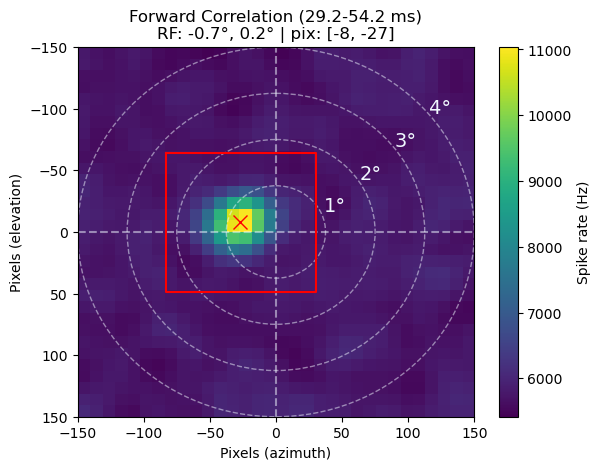

In [ ]:
#%%

# Parameters for dataset rois
roi_r = 1.5 # degrees
r_pix = int(roi_r * ppd)
roi_src = np.stack([rf_pix - r_pix, rf_pix + r_pix + 1], axis=1)

plt.figure()
plt.imshow(rf, extent=[j_edges[0], j_edges[-1], i_edges[-1], i_edges[0]], aspect='auto')
plt.axvline(0, color='aliceblue', linestyle='--', alpha=.5)
plt.axhline(0, color='aliceblue', linestyle='--', alpha=.5)
for r in np.arange(1, 5):
    plt.gca().add_patch(Circle((0, 0), r*ppd, fill=False, color='aliceblue', linestyle='--', alpha=.5))
    plt.text(np.sqrt(2)/2*r*ppd+10, -np.sqrt(2)/2*r*ppd+10, f'{r}°', color='aliceblue', fontsize=14)
plt.plot([roi_src[1, 0], roi_src[1, 1], roi_src[1, 1], roi_src[1, 0], roi_src[1, 0]],
        [roi_src[0, 0], roi_src[0, 0], roi_src[0, 1], roi_src[0, 1], roi_src[0, 0]], 'r')
plt.plot([rf_pix[1]], [rf_pix[0]], 'rx', markersize=10)
plt.colorbar(label='Spike rate (Hz)')
plt.title(f'Forward Correlation ({lags[0]*dt*1000:.1f}-{lags[-1]*dt*1000:.1f} ms)\nRF: {rf_deg[0]:.1f}°, {rf_deg[1]:.1f}° | pix: [{rf_pix[0]}, {rf_pix[1]}]')
plt.xlabel('Pixels (azimuth)')
plt.ylabel('Pixels (elevation)')
plt.show()

In [ ]:
#%%

protocols = get_trial_protocols(exp)

# Metadata for all datasets
screen_resolution = (exp['S']['screenRect'][2:] - exp['S']['screenRect'][:2]).astype(int)
screen_width = exp['S']['screenWidth']
screen_distance = exp['S']['screenDistance']
screen_height = screen_width * screen_resolution[1] / screen_resolution[0]

metadata={
    'screen_resolution': screen_resolution,
    'screen_width': screen_width,
    'screen_height': screen_height,
    'screen_distance': screen_distance,
    'ppd': ppd,
    'roi_src': roi_src,
}

def generate_gaborium_dataset(exp, ks_results, ep_interp, roi_src, dt=1/240, metadata={}, trial_subset=.5):
    protocols = get_trial_protocols(exp)
    st = ks_results.spike_times
    clu = ks_results.spike_clusters
    cids = np.unique(clu)

    # Export Gaborium dataset
    gaborium_trials = [(iT, GaboriumTrial(exp['D'][iT], exp['S'])) for iT in range(len(exp['D'])) if protocols[iT] == 'ForageGabor']
    print(f'There are {len(gaborium_trials)} Gaborium trials. Using {trial_subset*100:.0f}% of them.')
    n_trials = int(len(gaborium_trials) * trial_subset)
    print(f'Using {n_trials} trials.')
    trial_inds = np.random.choice(len(gaborium_trials), n_trials, replace=False)
    gaborium_trials = [gaborium_trials[iT] for iT in trial_inds]
    gaborium_dict = {
        't_bins': [],
        'trial_inds': [],
        'stim': [],
        'robs': [],
        'dpi_pix': [],
        'dpi_valid': [],
        'roi': [],
    }
    for iT, trial in tqdm(gaborium_trials, 'Regenerating Gaborium Stimulus'):
        # get flip times in ephys time
        flip_times = ptb2ephys(trial.flip_times)

        # Setup bins
        trial_bin_edges = np.arange(flip_times[0], flip_times[-1], dt)
        trial_bins = trial_bin_edges[:-1] + dt/2
        gaborium_dict['t_bins'].append(trial_bins)
        gaborium_dict['trial_inds'].append(np.ones_like(trial_bins) * iT)

        # Get DPI
        trial_dpi = ep_interp(trial_bins)
        gaborium_dict['dpi_pix'].append(trial_dpi)
        gaborium_dict['dpi_valid'].append(valid_interp(trial_bins))

        # Get ROI
        trial_roi = trial_dpi[...,None].astype(int) + roi_src[None,...]
        gaborium_dict['roi'].append(trial_roi)

        # Get the frame index for each bin 
        frame_inds = np.searchsorted(flip_times, trial_bins) - 1
        frame_inds[frame_inds < 0] = 0

        # Sample the stimulus for each frame
        trial_stim = trial.get_frames(frame_inds, roi=trial_roi)
        gaborium_dict['stim'].append(trial_stim)

        # Bin spikes
        trial_robs = bin_spikes(st, trial_bin_edges, clu, cids)
        gaborium_dict['robs'].append(trial_robs)

    if gaborium_trials:
        for k, v in gaborium_dict.items():
            gaborium_dict[k] = np.concatenate(v)

        return DictDataset(gaborium_dict, metadata=metadata)
    else:
        return None

In [ ]:
#%%

global dset
dset_file = data_dir / 'gaborium.dset'
if dset_file.exists():
    dset = DictDataset.load(dset_file)
else:
    dset = generate_gaborium_dataset(exp, ks_results, dpi_interp, roi_src, dt=dt, metadata=metadata)
    dset.save(dset_file)

In [ ]:
#%%

valid_radius = 10
n_lags = 20
    
# Normalize stimulus
dset['stim'] = dset['stim'].float()
dset['stim'] = (dset['stim'] - dset['stim'].mean()) / dset['stim'].std()

# Convert DPI signal from pixel locations to degrees (using small angle approximation)
dpi_pix = dset['dpi_pix'].float()
pix_per_deg = dset.metadata['ppd']
screen_resolution = dset.metadata['screen_resolution']
center_pix = np.flipud((screen_resolution + 1) / 2)
dpi_deg = (dpi_pix - center_pix) / pix_per_deg
dpi_deg[:,0] *= -1
dpi_deg = dpi_deg[:,[1,0]]
dset['eyepos'] = dpi_deg.float().double()

# Create a binary mask for valid eye positions
valid_mask = np.logical_and.reduce([
    np.abs(dset['eyepos'][:,0]) < valid_radius, 
    np.abs(dset['eyepos'][:,1]) < valid_radius,
    dset['dpi_valid']
])
for iL in range(n_lags):
    valid_mask &= np.roll(valid_mask, 1, axis=0)
valid_inds = np.where(valid_mask)[0]

<ipython-input-7-154ff6f4671a>:15: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  dpi_deg = (dpi_pix - center_pix) / pix_per_deg
<ipython-input-7-154ff6f4671a>:22: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  np.abs(dset['eyepos'][:,0]) < valid_radius,
<ipython-input-7-154ff6f4671a>:23: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  np.abs(dset['eyepos'][:,1]) < valid_radius,


Calculating STA: 100%|██████████| 340/340 [00:24<00:00, 13.65it/s]


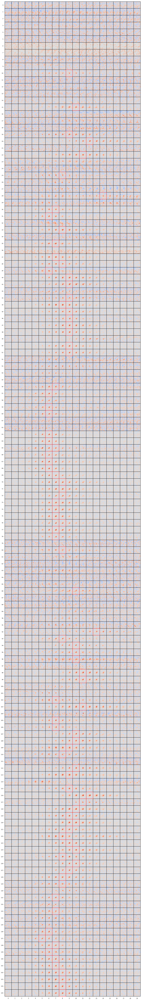

Removed 90 bad clusters. 90 clusters remain.


In [ ]:
#%%

snr_thresh = 5
min_num_spikes = 500

# Calculate spike-triggered stimulus energy (STE)
# Determine maximally responsive lag for each cluster
stes = calc_sta(dset['stim'], dset['robs'], 
                n_lags, inds=valid_inds, device='cuda', batch_size=10000,
                stim_modifier=lambda x: x**2, progress=True).cpu().numpy()

# Find maximum energy lag for each cluster
signal = np.abs(stes - np.median(stes, axis=(2,3), keepdims=True))
sigma = [0, 2, 2, 2]
signal = gaussian_filter(signal, sigma)
noise = np.median(signal[:,0], axis=(1,2))
snr_per_lag = np.max(signal, axis=(2,3)) / noise[:,None]
cluster_lag = snr_per_lag.argmax(axis=1)

# Shift robs to maximally responsive lag for each cluster 
n_frames = len(dset['robs'])
robs = []
for iC in range(dset['robs'].shape[1]):
    lag = cluster_lag[iC]
    max_frame = n_frames + lag - n_lags
    robs.append(dset['robs'][lag:max_frame,iC])
robs = torch.stack(robs, axis=1)

dset.replicates = True
dset = dset[:-n_lags]
dset['robs'] = robs
dset = dset[valid_mask[:-n_lags]]
dset.replicates = False

# Remove bad clusters
good_ix = np.where(np.max(snr_per_lag, axis=1) > snr_thresh)[0]
good_ix = np.intersect1d(good_ix, np.where(dset['robs'].sum(0) > min_num_spikes)[0])
dset['robs'] = dset['robs'][:,good_ix]
n_units = len(good_ix)

# Plot STEs
fig, axs = plot_stas((stes - np.median(stes, axis=(2,3), keepdims=True))[:,:,None,:,:])
for iC in good_ix:
    iL = cluster_lag[iC]
    x0, x1 = iL, (iL+1)
    y0, y1 = -iC-1, -iC
    axs.plot([x0, x1, x1, x0, x0], [y1, y1, y0, y0, y1], 'r-')
plt.show()
print(f'Removed {len(good_ix)} bad clusters. {len(dset["robs"][0])} clusters remain.')

In [ ]:
#%%

for key in dset.keys():
    if torch.is_tensor(dset[key]):
        dset[key] = dset[key].to(torch.float32)

print(dset)

DictDataset
	t_bins (cpu): 650.36 KB - 166493 (torch.float32)
	trial_inds (cpu): 650.36 KB - 166493 (torch.float32)
	stim (cpu): 7.92 GB - 166493 x 113 x 113 (torch.float32)
	robs (cpu): 57.16 MB - 166493 x 90 (torch.float32)
	dpi_pix (cpu): 1.27 MB - 166493 x 2 (torch.float32)
	dpi_valid (cpu): 650.36 KB - 166493 (torch.float32)
	roi (cpu): 2.54 MB - 166493 x 2 x 2 (torch.float32)
	eyepos (cpu): 1.27 MB - 166493 x 2 (torch.float32)
	Metadata:
		screen_resolution: ndarray
		screen_width: ndarray
		screen_height: float64
		screen_distance: ndarray
		ppd: ndarray
		roi_src: ndarray



<ipython-input-10-b786ae61d6b9>:19: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  grid += grid_center[None,None,:]


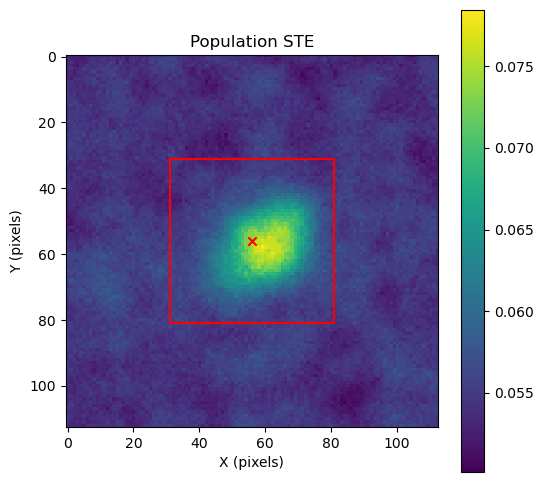

DictDataset
	t_bins (cpu): 650.36 KB - 166493 (torch.float32)
	trial_inds (cpu): 650.36 KB - 166493 (torch.float32)
	stim (cpu): 7.92 GB - 166493 x 113 x 113 (torch.float32)
	robs (cpu): 57.16 MB - 166493 x 90 (torch.float32)
	dpi_pix (cpu): 1.27 MB - 166493 x 2 (torch.float32)
	dpi_valid (cpu): 650.36 KB - 166493 (torch.float32)
	roi (cpu): 2.54 MB - 166493 x 2 x 2 (torch.float32)
	eyepos (cpu): 1.27 MB - 166493 x 2 (torch.float32)
	Metadata:
		screen_resolution: ndarray
		screen_width: ndarray
		screen_height: float64
		screen_distance: ndarray
		ppd: ndarray
		roi_src: ndarray
		valid_radius: int
		grid_center: ndarray
		snr_thresh: int
		min_num_spikes: int
		grid: Tensor



In [ ]:
#%%

grid_radius = 25
# Construct grid centered on peak of spatial STEs
_, _, n_y, n_x = stes.shape
weights = (dset['robs'].sum(dim=0) / dset['robs'].sum()).cpu().numpy()
ste_max = np.zeros((n_y, n_x))
for i, iC in enumerate(good_ix):
    lag = cluster_lag[iC]
    ste_max += stes[iC, lag] * weights[i]

grid_center = np.array((n_x, n_y)) // 2
grid = torch.stack(
            torch.meshgrid(
                torch.arange(-grid_radius,grid_radius+1), 
                torch.arange(-grid_radius,grid_radius+1),
                indexing='xy'
            ), 
            dim=-1).float()
grid += grid_center[None,None,:]

x_min, x_max = grid[...,0].min(), grid[...,0].max()
y_min, y_max = grid[...,1].min(), grid[...,1].max()

fig, axs = plt.subplots(1, 1, figsize=(6, 6))
im = axs.imshow(ste_max, cmap='viridis')
fig.colorbar(im, ax=axs)
axs.plot([x_min, x_min, x_max, x_max, x_min], [y_min, y_max, y_max, y_min, y_min], color='red')
axs.scatter([grid_center[0]], [grid_center[1]], color='red', marker='x')
axs.set_title('Population STE')
axs.set_xlabel('X (pixels)')
axs.set_ylabel('Y (pixels)')
plt.show()

# store meta data
dset.metadata['valid_radius'] = valid_radius
dset.metadata['grid_center'] = grid_center
dset.metadata['snr_thresh'] = snr_thresh
dset.metadata['min_num_spikes'] = min_num_spikes
dset.metadata['grid'] = grid

print(dset)

In [ ]:
#%%

# Main class
class MLPPixelShifter(nn.Module):
    def __init__(self, grid, 
                hidden_dims=100,
                weight_init_multiplier=1, 
                input_dim=2,
                anchored=True,
                mode='bilinear') -> None:
        
        super(MLPPixelShifter, self).__init__()
        self.input_dim = input_dim
        self.grid = nn.Parameter(grid.float(), requires_grad=False) # grid is tensor of shape (n_row, n_col, 2)
        self.hidden_dims = hidden_dims
        self.weight_init_multiplier = weight_init_multiplier
        self.set_mode(mode)

        self.anchored = anchored

        # If hidden_dims is a scalar integer, convert it to a list with one element
        if isinstance(hidden_dims, int):
            hidden_dims = [hidden_dims]

        # Dynamically create the layers using hidden_dims list
        layers = []
        for i in range(len(hidden_dims)):
            if i == 0:
                layers.append(nn.Linear(input_dim, hidden_dims[0]))
            else:
                layers.append(nn.Linear(hidden_dims[i-1], hidden_dims[i], bias=True))
            layers.append(nn.GELU())

        layers.append(nn.Linear(hidden_dims[-1], 2, bias=True))

        self.layers = nn.Sequential(*layers)

        # Initialize weights for all layers
        for layer in self.layers:
            if isinstance(layer, nn.Linear):
                layer.weight.data *= weight_init_multiplier
        
    def anchor(self):
        p0 = self.layers(torch.zeros(self.input_dim, device=self.grid.device))
        self.layers[-1].bias.data -= p0 # subtract the shift at the origin from the bias

    def forward(self, x):
        if self.anchored:
            self.anchor()
        x['stim_in'] = x['stim']
        stim = x['stim']
        if stim.ndim == 3:
            stim = stim.unsqueeze(1) # add channel dimension

        n_frames, _,n_y, n_x = stim.shape

        shift = x['eyepos']
        shift_out = self.layers(shift).squeeze(dim=1)
        grid_shift = shift_out[:, None, None, :] + self.grid[None, ...]
        _, n_y_grid, n_x_grid, _ = grid_shift.shape

        frame_grid = torch.arange(n_frames, device=self.grid.device).float() \
                          .repeat(n_y_grid, n_x_grid, 1) \
                          .permute(2, 0, 1) \
                          .unsqueeze(-1)

        sample_grid = torch.cat([grid_shift, frame_grid], dim=-1) # 1 x T x Y x X x 3 (x, y, frame)
        extent = [
                [0, n_frames - 1],
                [0, n_y - 1],
                [0, n_x - 1]
        ]

        out = grid_sample_coords(stim.permute(1,0,2,3)[None,...], # 1 x C x T x Y x X  
                                 sample_grid[None,...], 
                                 extent, 
                                 mode=self.mode,
                                 padding_mode='zeros',
                                 align_corners=True,
                                 no_grad=False)
        out = out.squeeze(dim=(0, 1))
        x['shift_out'] = shift_out
        x['stim'] = out

        return x
    def set_mode(self, mode):
        assert mode in ['nearest', 'bilinear'], 'mode must be "nearest" or "bilinear"'
        self.mode = mode

    def plot_shifts(self, x_min, x_max, y_min, y_max, image_resolution=50, quiver_resoluiton=10):

        with torch.no_grad():
            x_im = torch.linspace(x_min, x_max, image_resolution, device=self.grid.device)
            y_im = torch.linspace(y_min, y_max, image_resolution, device=self.grid.device)
            xy_im = torch.stack(
                torch.meshgrid(x_im, y_im, indexing='xy'),
                dim=-1)
                
            x_qv = torch.linspace(x_min, x_max, quiver_resoluiton, device=self.grid.device)
            y_qv = torch.linspace(y_min, y_max, quiver_resoluiton, device=self.grid.device)
            xy_qv = torch.stack(
                torch.meshgrid(x_qv, y_qv, indexing='xy'),
                dim=-1)

            shift_im = self.layers(xy_im).norm(dim=-1)
            shift_qv = self.layers(xy_qv)        
        fig, axs = plt.subplots(1,1, figsize=(6, 6))
        im = axs.imshow(shift_im.cpu(), extent=[x_min, x_max, y_min, y_max], origin='lower')
        fig.colorbar(im, ax=axs)
        axs.quiver(xy_qv[...,0].cpu(),
                   xy_qv[...,1].cpu(), 
                   shift_qv[...,1].cpu(), 
                   -shift_qv[...,0].cpu(), 
                   color='red')
        return fig, axs

# CNN model
class StimulusCNN(nn.Module):
    def __init__(self, dims, kernel_sizes,
                channels,
                n_units, strides=None,
                normalize_spatial_weights=False,
                fr_init = None,
                 ) -> None:
        super(StimulusCNN, self).__init__()
        
        self.dims = dims
        self.normalize_spatial_weights = normalize_spatial_weights

        if isinstance(kernel_sizes, int):
            kernel_sizes = [kernel_sizes]
        if isinstance(channels, int):
            channels = [channels]
        assert len(kernel_sizes) == len(channels), 'kernel_sizes and channels must have the same length'
        if strides is None:
            strides = [1] * len(kernel_sizes)
        assert len(strides) == len(kernel_sizes), 'strides must have the same length as kernel_sizes'
        
        n_layers = len(kernel_sizes)
        layers = []
        for i in range(n_layers):
            in_channels = dims[0] if i == 0 else channels[i-1] * 2
            out_channels = channels[i]
            layers.append(StackedConv2d(in_channels, out_channels, kernel_sizes[i], stride=strides[i], bias=False))
            layers.append(nn.BatchNorm2d(out_channels))
            layers.append(SplitRelu())

        # Calculate the output dimensions taking into account kernel sizes, strides, and pooling
        h, w = dims[1], dims[2]
        for i in range(n_layers):
            h = (h - kernel_sizes[i]) // strides[i] + 1
            w = (w - kernel_sizes[i]) // strides[i] + 1

        dims_out = [channels[-1]*2, h, w]
        readout = NonparametricReadout(dims_out, n_units)
            
        layers.append(readout)
        layers.append(nn.Softplus())

        self.layers = nn.Sequential(*layers)

        inv_softplus = lambda x, beta=1: torch.log(torch.exp(beta*x) - 1) / beta
        if fr_init is not None:
            assert len(fr_init) == n_units, 'init_rates must have the same length as n_units'
            self.layers[-2].bias.data = inv_softplus(
                ensure_tensor(fr_init, device=self.layers[-2].bias.device)
            )


    def forward(self, x):
        # normalize spatial weights
        for layer in self.layers:
            if hasattr(layer, 'normalize_spatial_weights'):
                layer.normalize_spatial_weights()

        stim = x['stim'].float()
        if stim.ndim == 3:  # missing channel dimension
            stim = stim.unsqueeze(1) 
        x['rhat'] = self.layers(stim).squeeze()
        return x

class ShifterModel(nn.Module):
    def __init__(self, shifter_hparams, cnn_hparams):
        super(ShifterModel, self).__init__()
        self.shifter = MLPPixelShifter(**shifter_hparams)
        self.cnn = StimulusCNN(**cnn_hparams)
    
    def forward(self, x):
        x = self.shifter(x)
        x = self.cnn(x)
        return x

In [ ]:
#%%

set_seeds(1002)
# Data loaders
train_set, val_set = torch.utils.data.random_split(dset, [.8, .2])
train_loader = torch.utils.data.DataLoader(train_set, batch_size=args.batch_size, shuffle=True, num_workers=os.cpu_count(), pin_memory=True)
val_loader = torch.utils.data.DataLoader(val_set, batch_size=args.batch_size, shuffle=False, num_workers=os.cpu_count(), pin_memory=True)

# shifter params
shifter_kwargs = {
    'grid': dset.metadata['grid'],
    'weight_init_multiplier': 1,
    'hidden_dims': [400],
}
# CNN params
cnn_kwargs = {
    'dims': (1, dset.metadata['grid'].shape[0], dset.metadata['grid'].shape[1]),
    'kernel_sizes': [21, 11],
    'channels': [16, 16],
    'n_units': n_units,
    'normalize_spatial_weights': False,
    'fr_init': train_set[:]['robs'].mean(dim=0),
}

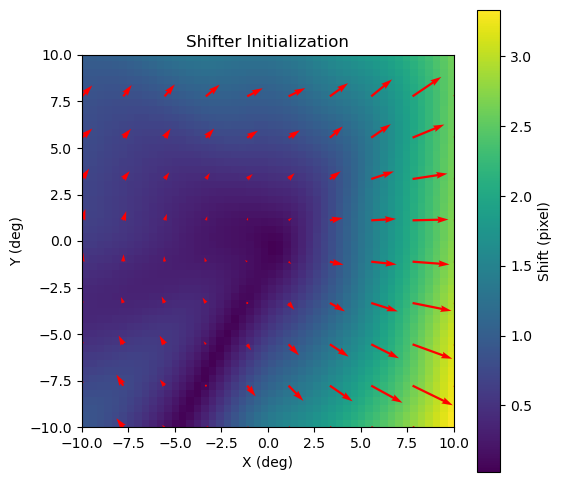

Validation: 100%|██████████| 261/261 [00:16<00:00, 15.45it/s]


Validation BPS: -0.0053097521886229515


Validation: 100%|██████████| 261/261 [00:15<00:00, 17.12it/s]

Validation BPS: 0.3214554786682129


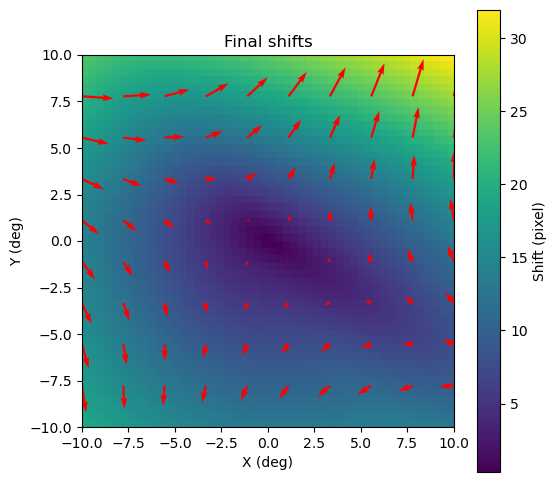

In [ ]:
# %%

optimizer_hparams = {
    'lr': 1e-3,
    'weight_decay': 1e-3,
    'betas': (0.9, 0.999),
}
model = ShifterModel(shifter_kwargs, cnn_kwargs)
optimizer = torch.optim.AdamW(model.parameters(), **optimizer_hparams)

val_bps_aggregator = PoissonBPSAggregator()
n_epochs = args.max_epochs

def train_epoch():
    for batch in (pbar := tqdm(train_loader, f'Epoch {epoch}')):
        optimizer.zero_grad()
        output = model(batch)
        loss = F.poisson_nll_loss(output['rhat'], batch['robs'], log_input=False, full=False)
        loss.backward()
        optimizer.step()
        #scheduler.step(loss, epoch)
        pbar.set_postfix({'loss': loss.item()})

def validate():
    with torch.no_grad():
        for batch in tqdm(val_loader, f'Validation'):
            output = model(batch)
            val_bps_aggregator(output)
        val_bps = val_bps_aggregator.closure().mean().item()
        print(f'Validation BPS: {val_bps}')
        val_bps_aggregator.reset()
        return val_bps

fig, axs = model.shifter.plot_shifts(-dset.metadata['valid_radius'], dset.metadata['valid_radius'], -dset.metadata['valid_radius'], dset.metadata['valid_radius'])
axs.set_title('Shifter Initialization')
axs.set_xlabel('X (deg)')
axs.set_ylabel('Y (deg)')
axs.images[0].colorbar.set_label('Shift (pixel)')
plt.show()
    
validate()
for epoch in range(n_epochs):
    train_epoch()
    validate()

fig, axs = model.shifter.plot_shifts(-dset.metadata['valid_radius'], dset.metadata['valid_radius'], -dset.metadata['valid_radius'], dset.metadata['valid_radius'])
axs.set_title('Final shifts')
axs.set_xlabel('X (deg)')
axs.set_ylabel('Y (deg)')
axs.images[0].colorbar.set_label('Shift (pixel)')
plt.show()

In [ ]:
# %%

# Get and display stas pre and post shifting

i_slc = slice(grid_center[0] - grid_radius, grid_center[0] + grid_radius + 1)
j_slc = slice(grid_center[1] - grid_radius, grid_center[1] + grid_radius + 1)
pre_stas = calc_sta(dset['stim'][:,i_slc, j_slc], dset['robs'], [0], batch_size=2048, device='cuda', progress=True).detach().cpu().numpy().squeeze()
pre_stes = calc_sta(dset['stim'][:,i_slc, j_slc], dset['robs'], [0], batch_size=2048, device='cuda', stim_modifier=lambda x: x**2, progress=True).detach().cpu().numpy().squeeze()

with torch.no_grad():
    shifted_dset = model.shifter(dset[:])
shifted_stas = calc_sta(shifted_dset['stim'], dset['robs'], [0], batch_size=2048, device='cuda', progress=True).detach().cpu().numpy().squeeze()
shifted_stes = calc_sta(shifted_dset['stim'], dset['robs'], [0], batch_size=2048, device='cuda', stim_modifier=lambda x: x**2, progress=True).detach().cpu().numpy().squeeze()

Calculating STA: 100%|██████████| 82/82 [00:00<00:00, 446.65it/s]


In [ ]:
#%%

stas = np.stack([pre_stas, shifted_stas], axis=1)
stas /= np.max(np.abs(stas), axis=(1,2,3), keepdims=True)
stes = np.stack([pre_stes, shifted_stes], axis=1)
stes -= np.median(stes, axis=(2,3), keepdims=True)
stes /= np.max(np.abs(stes), axis=(1,2,3), keepdims=True)

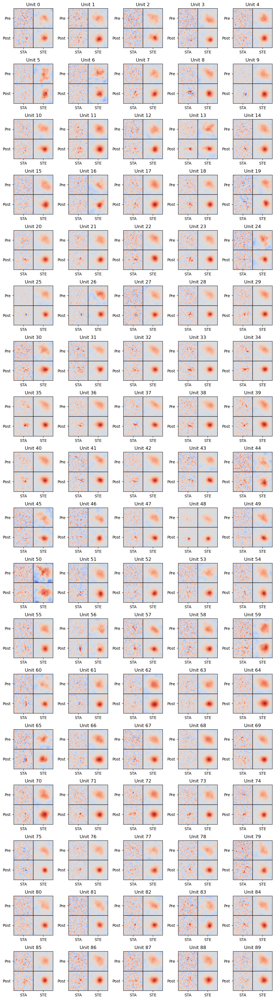

In [ ]:
#%%

n_cols = 5
n_rows = np.ceil(n_units / n_cols).astype(int)
fig, axs = plt.subplots(n_rows, n_cols, figsize=(n_cols*2, n_rows*2))
for iU in range(n_units):
    ax = axs.flatten()[iU]
    ax.set_title(f'Unit {iU}')
    ax.imshow(stas[iU,0], cmap='coolwarm', vmin=-1, vmax=1, 
                extent=[0, 1, 0, 1])
    ax.imshow(stes[iU,0], cmap='coolwarm', vmin=-1, vmax=1, 
                extent=[1, 2, 0, 1])
    ax.imshow(stas[iU,1], cmap='coolwarm', vmin=-1, vmax=1, 
                extent=[0, 1, 1, 2])
    ax.imshow(stes[iU,1], cmap='coolwarm', vmin=-1, vmax=1, 
                extent=[1, 2, 1, 2])
    ax.plot([0, 2], [1, 1], 'k-', linewidth=1)
    ax.plot([1, 1], [0, 2], 'k-', linewidth=1)
    ax.set_xlim([0, 2])
    ax.set_ylim([2, 0])
    ax.set_xticks([0.5, 1.5], ['STA', 'STE'])
    ax.set_yticks([0.5, 1.5], ['Pre', 'Post'])
    
for ax in axs.flatten()[n_units:]:
    ax.axis('off')

# reduce the distance between subplots
fig.subplots_adjust(hspace=0.01, wspace=0.03)
# add colorbar
fig.tight_layout()
plt.show()